In [2]:
import pandas as pd
import numpy as np
import string, re
import itertools
import nltk
import plotly.offline as py
import plotly.graph_objs as go
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud,STOPWORDS

In [3]:
df =pd.read_table("Final_data.txt")
def preprocess_data(df):
    
    # Convert text to lowercase
    df['review_body'] = df['review_body'].str.strip().str.lower()
    return data
(df.head())

,Unnamed: 0,review_body,sentiment
0,0,absolutely love watch get compliments almost e...,1
1,1,love watch keeps time wonderfully.,1
2,2,scratches,2
3,3,"works well me. however, found cheaper prices p...",1
4,4,beautiful watch face. band looks nice around. ...,1


In [4]:
print(df.shape)
print(df.dropna().shape)

(960049, 3)
(959378, 3)


In [5]:
lens = df['review_body'].str.len()
print(lens.mean(), lens.std(), lens.min(), lens.max())

167.16418241819179 257.36584921301363 1.0 19355.0


In [15]:
data = [go.Histogram(x=lens, xbins=dict(start=0, end=8000, size=50), marker=dict(color='#8c42f4'))]
py.init_notebook_mode()
layout = go.Layout(
                  title='Length of reviews distribution',                  
                  xaxis=dict(title='Length'),
                  yaxis=dict(title='Count'),
                  bargap=0.1)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='length histogram')


In [7]:
wordcloud1 = WordCloud( background_color='black', width=800, height=600)
wordcloud2 = WordCloud( background_color='black', width=800, height=600)
wordcloud3 = WordCloud( background_color='black', width=800, height=600)

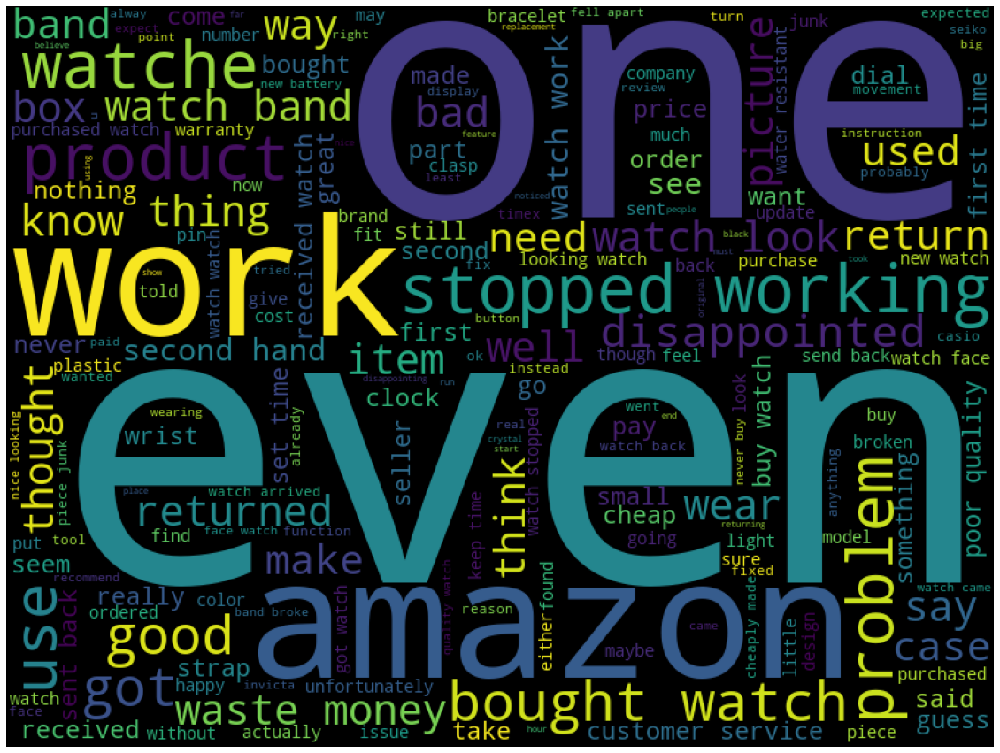

In [8]:
df_neg = ' '.join(map(str,df[df['sentiment']==0]['review_body'])) 
wc = wordcloud1.generate(df_neg)
plt.figure(figsize=(20,30))
plt.imshow(wc)
plt.axis('off')
plt.show()

In [ ]:
df_pos = ' '.join(map(str,df[df['sentiment']==1]['review_body'])) 
wc = wordcloud2.generate(df_pos)
plt.figure(figsize=(20,30))
plt.imshow(wc)
plt.axis('off')
plt.show()

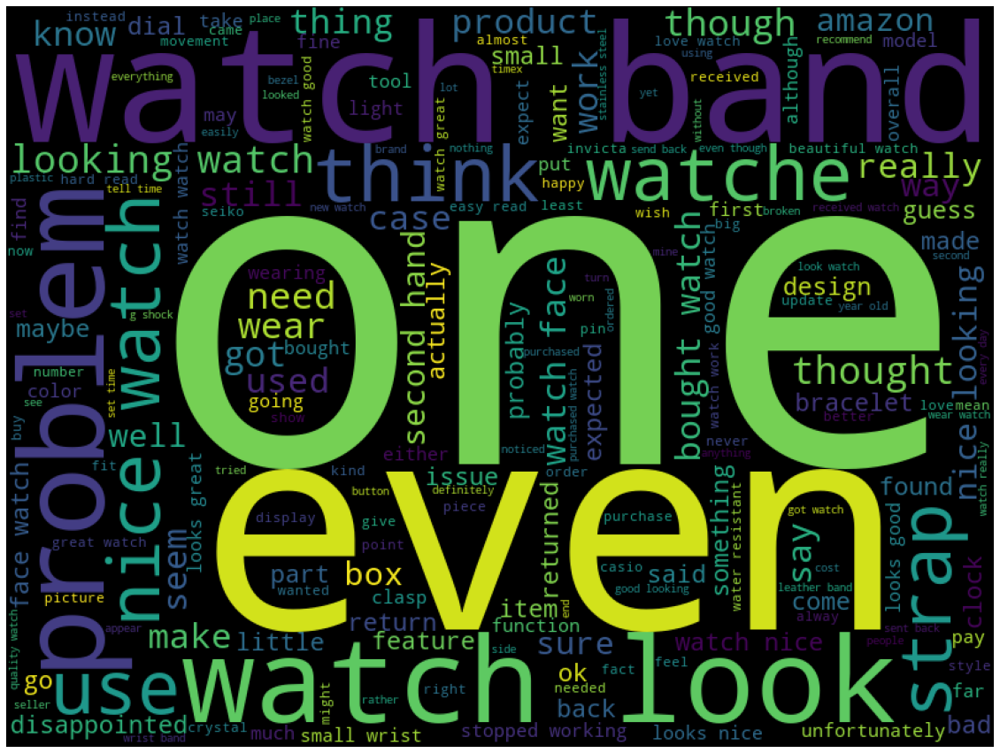

In [9]:
df_neu = ' '.join(map(str,df[df['sentiment']==2]['review_body'])) 
wc = wordcloud3.generate(df_neu)
plt.figure(figsize=(20,30))
plt.imshow(wc)
plt.axis('off')
plt.show()

In [12]:
review_length = df.review_body.str.split().str.len()
review_length.describe()

count    959378.000000
mean         25.076101
std          37.664601
min           1.000000
25%           8.000000
50%          15.000000
75%          29.000000
max        2772.000000
Name: review_body, dtype: float64

1: Positive
0: Negative
2: Neutral
Distribution of labels:
1    743829
2    131110
0     85110
Name: sentiment, dtype: int64


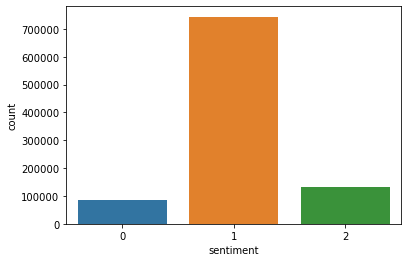

In [13]:
sns.countplot(x="sentiment", data=df);
print("1: Positive")
print("0: Negative")
print("2: Neutral")
print("Distribution of labels:")
print(df.sentiment.value_counts());